In [1]:
from run_dnerf import *
import matplotlib.pyplot as plt
import torch
from load_blender import pose_spherical
from run_dnerf_helpers import to8b
from load_nerfies import load_nerfies_data, load_nerfies_vali_data
import numpy as np
import json
import cv2
from tqdm import tqdm

/data/gpfs/projects/punim1485/kuoyuanl/anaconda3/envs/rignerf/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Detected device: cuda


In [2]:
# set cuda
torch.set_default_tensor_type('torch.cuda.FloatTensor')
#torch.set_default_tensor_type('torch.FloatTensor')
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# get config file
config_file = "configs/kuoyuan_home_glass.txt"
root_dir = "./kuoyuan_home_glass_renders"
parser = config_parser()
args = parser.parse_args(f'--config {config_file}')

In [3]:
train_output_path = os.path.join(root_dir,"./train_images")
if not os.path.exists(train_output_path):
    os.makedirs(train_output_path)
images, poses, warps, appearances, mesh_canonicals, mesh_deformeds,param_3DMM, near, far, hwf, i_split = load_nerfies_data(args.datadir, args.section, downscale = args.downscale)
frame_num = max(appearances)+1

## Load train data details

In [3]:
train_output_path = os.path.join(root_dir,"./train_images")
if not os.path.exists(train_output_path):
    os.makedirs(train_output_path)
images, poses, warps, appearances, mesh_canonicals, mesh_deformeds,param_3DMM, near, far, hwf, i_split = load_nerfies_data(args.datadir, args.section, downscale = args.downscale)
frame_num = max(appearances)+1
H, W, focal = hwf
H, W = int(H), int(W)
hwf = [H, W, focal]
i_train, i_val = i_split
# load the nerf model
_,render_kwargs_test,_,_,_ =  create_nerf(args,frame_num=frame_num)
bds_dict = {'near' : near,'far' : far}
render_kwargs_test.update(bds_dict)

# move data to device
N_rand = args.N_rand
images = torch.Tensor(images).to(device)
poses = torch.Tensor(poses).to(device)
warps = torch.Tensor(warps).to(device)
appearances = torch.Tensor(appearances).to(device)
param_3DMM = torch.Tensor(param_3DMM).to(device)
mesh_canonicals = torch.Tensor(mesh_canonicals).to(device)
mesh_deformeds = torch.Tensor(mesh_deformeds).to(device)

NeRF type selected: rignerf
Using two models for fine
NeRF type selected: rignerf
fine and coarse network created, frame_num is 2589
Found ckpts ['./logs/kuoyuan_home_glass/040000.tar', './logs/kuoyuan_home_glass/080000.tar', './logs/kuoyuan_home_glass/120000.tar', './logs/kuoyuan_home_glass/160000.tar', './logs/kuoyuan_home_glass/200000.tar', './logs/kuoyuan_home_glass/240000.tar', './logs/kuoyuan_home_glass/280000.tar']
Reloading from ./logs/kuoyuan_home_glass/280000.tar


  0%|          | 0/13 [00:00<?, ?it/s]/data/gpfs/projects/punim1485/kuoyuanl/anaconda3/envs/rignerf/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /opt/conda/conda-bld/pytorch_1666642975312/work/aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


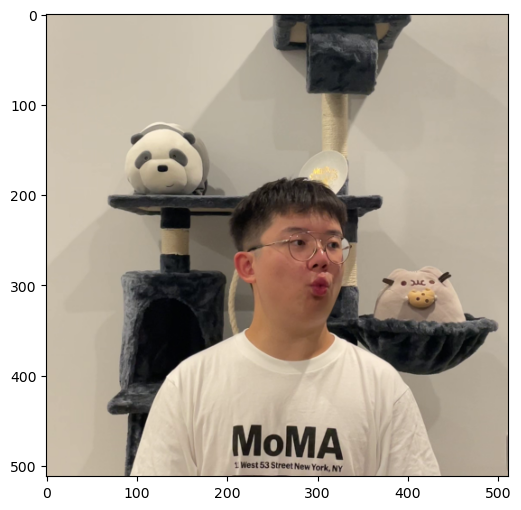

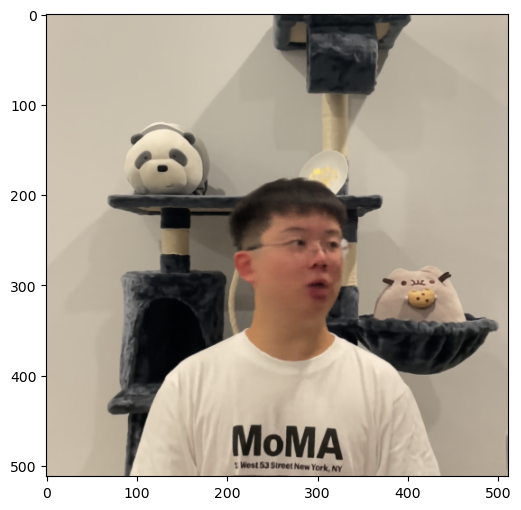


  8%|▊         | 1/13 [02:41<32:23, 161.94s/it]

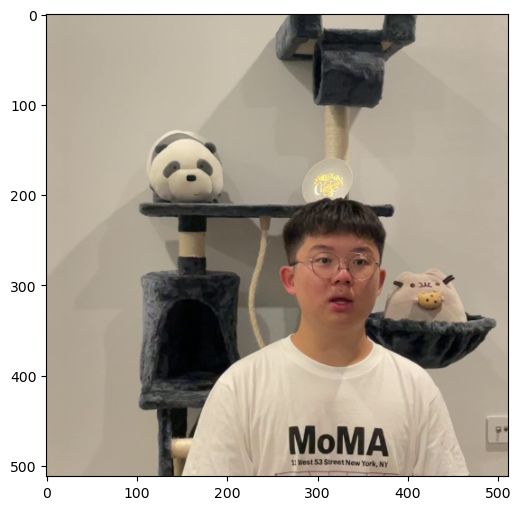

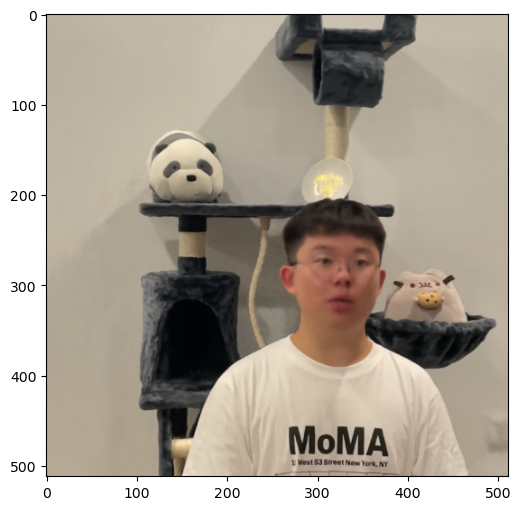


 15%|█▌        | 2/13 [06:23<36:06, 196.98s/it]

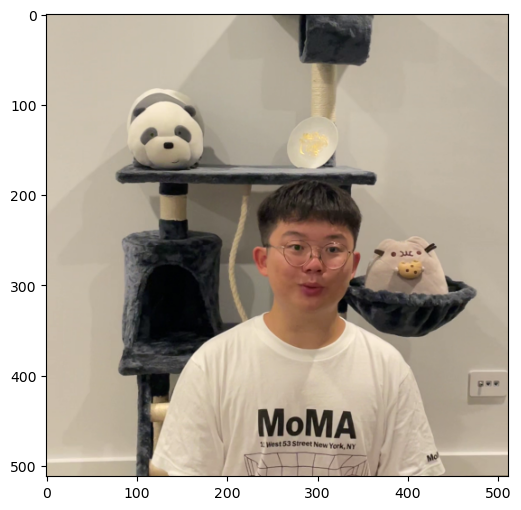

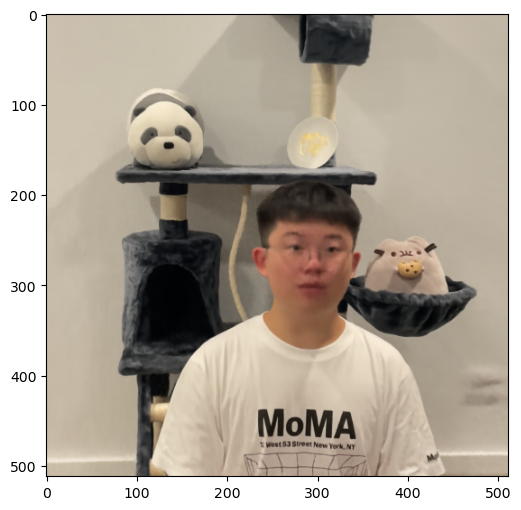


 23%|██▎       | 3/13 [09:46<33:19, 199.95s/it]

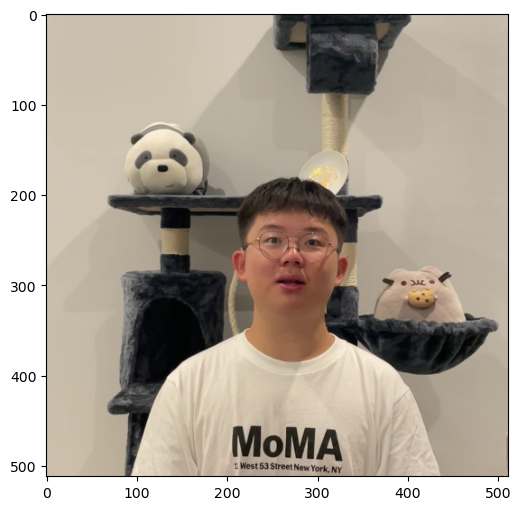

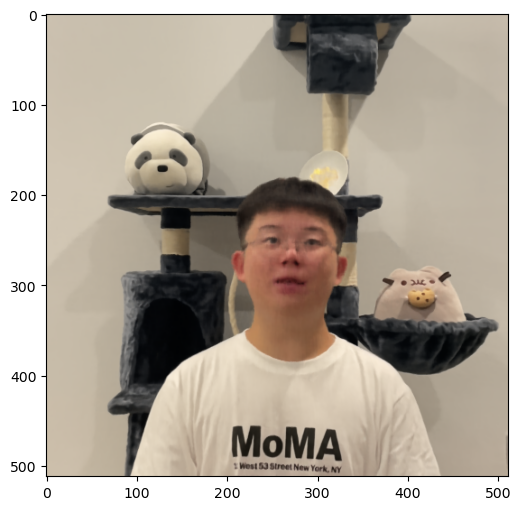


 31%|███       | 4/13 [12:51<29:06, 194.01s/it]

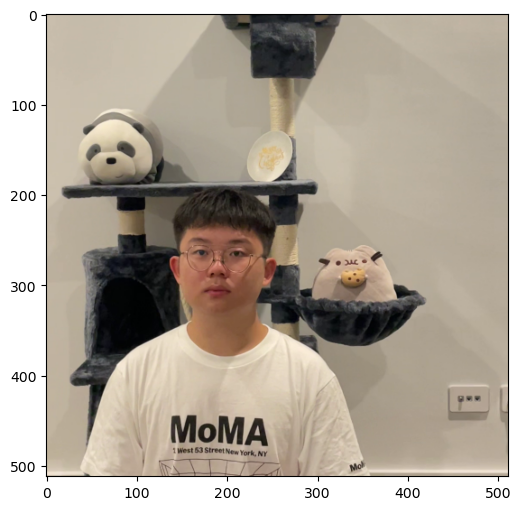

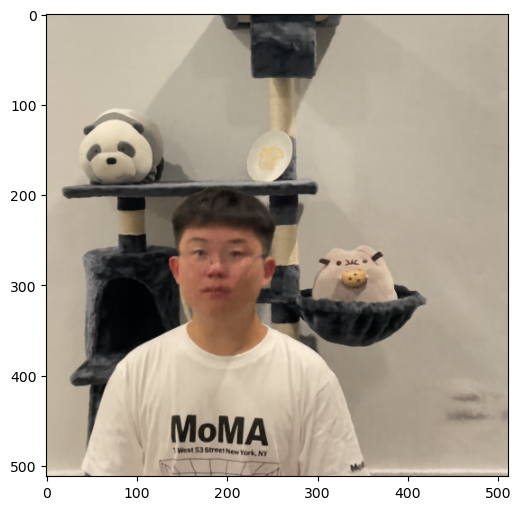


 38%|███▊      | 5/13 [16:16<26:22, 197.80s/it]

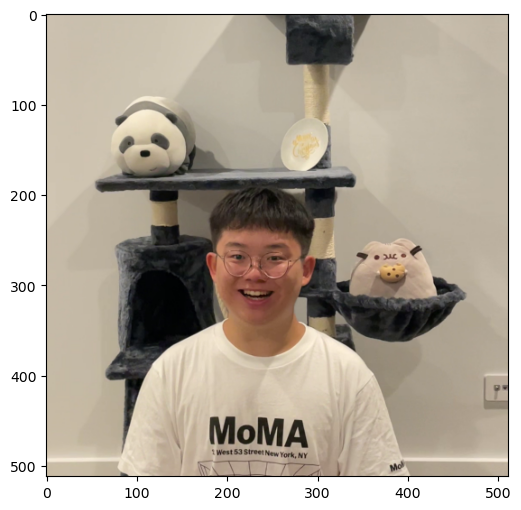

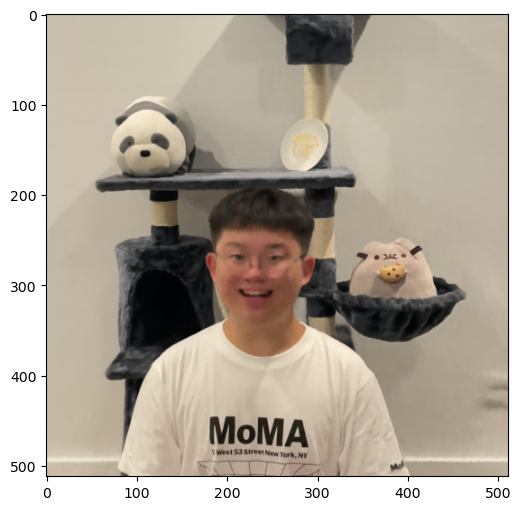


 46%|████▌     | 6/13 [19:31<22:58, 196.90s/it]

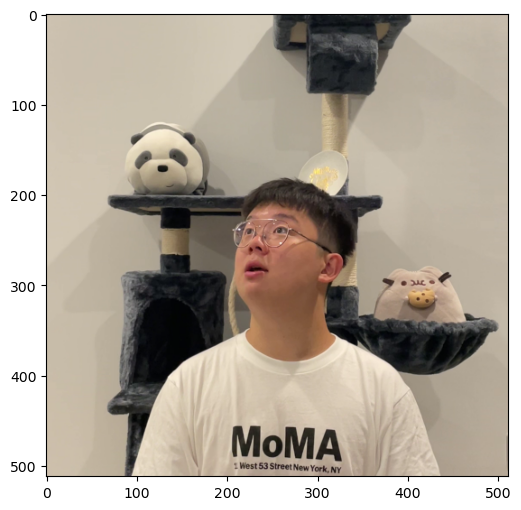

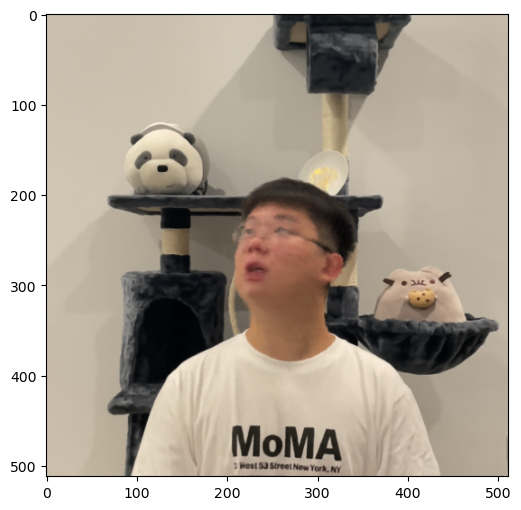


 54%|█████▍    | 7/13 [22:29<19:03, 190.67s/it]

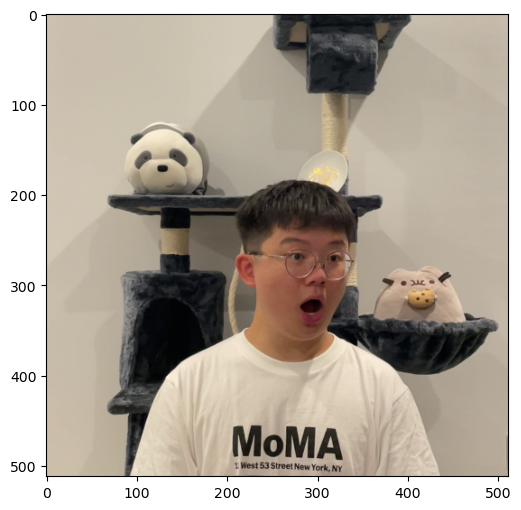

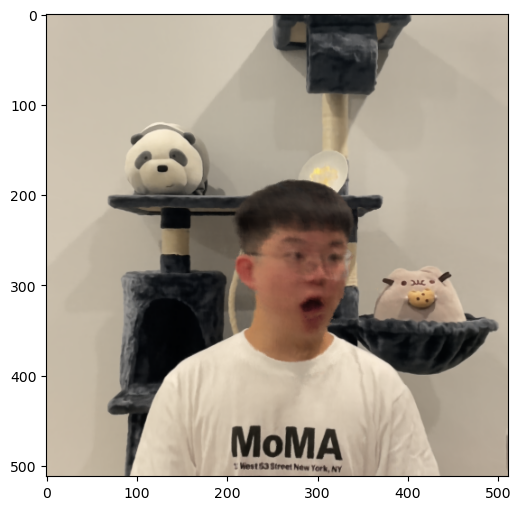


 62%|██████▏   | 8/13 [25:25<15:30, 186.19s/it]

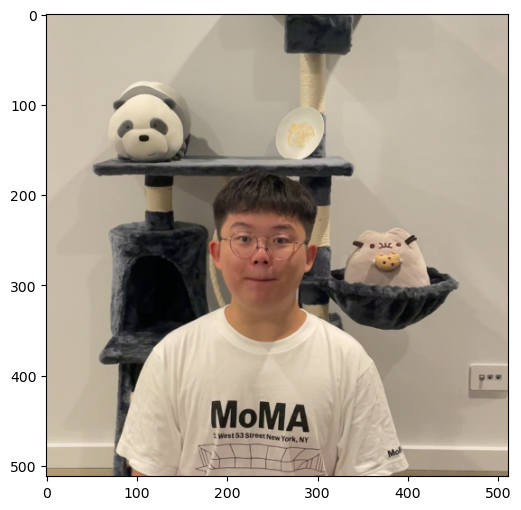

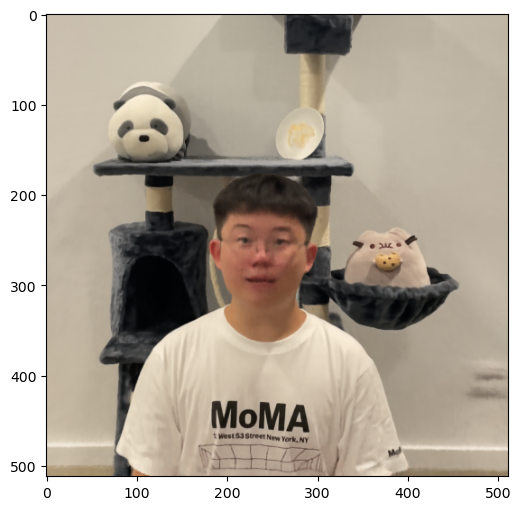


 69%|██████▉   | 9/13 [28:48<12:45, 191.31s/it]

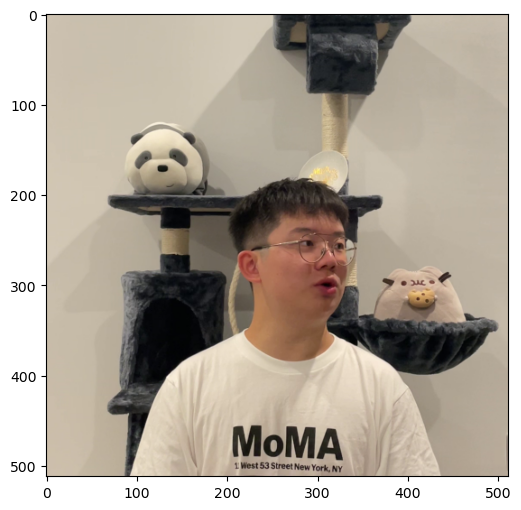

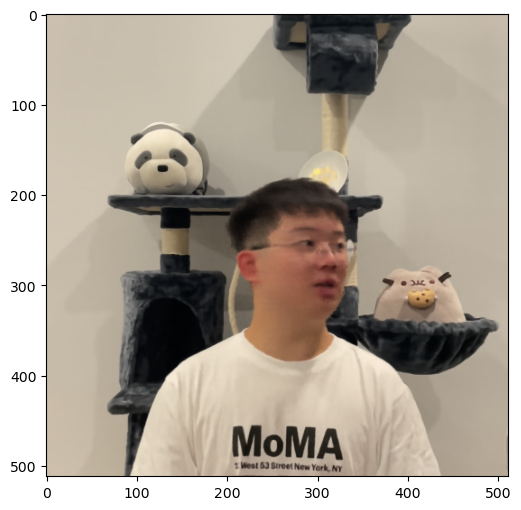


 77%|███████▋  | 10/13 [31:34<09:10, 183.58s/it]

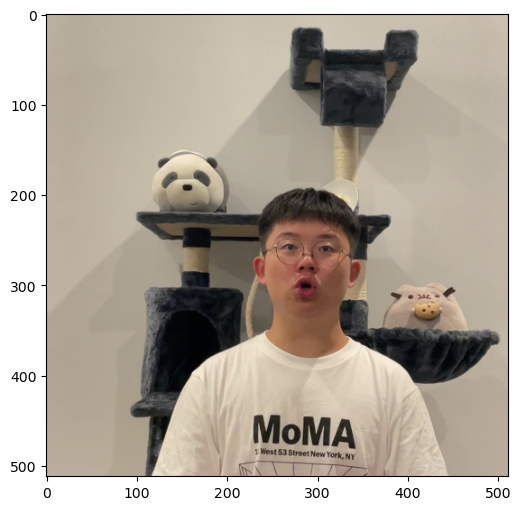

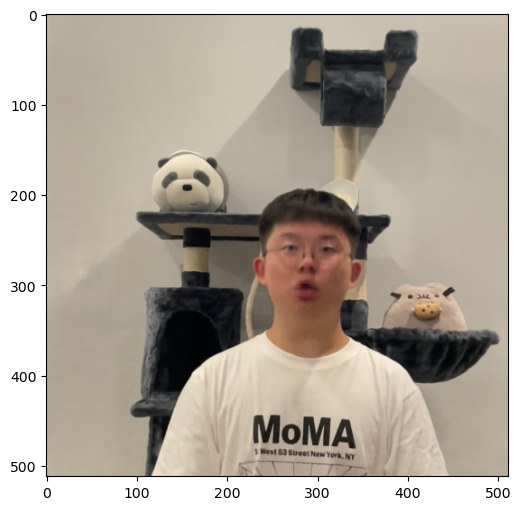


 85%|████████▍ | 11/13 [35:18<06:31, 195.74s/it]

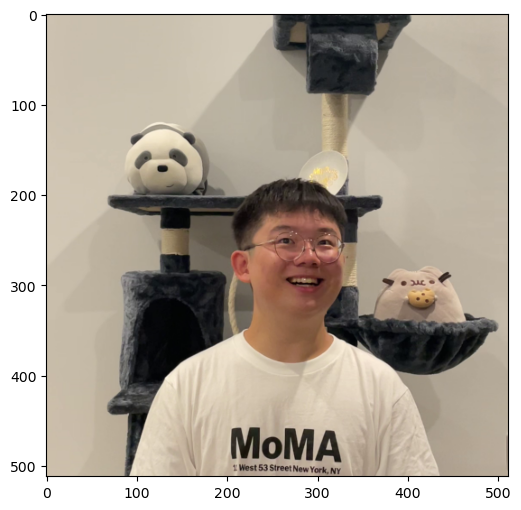

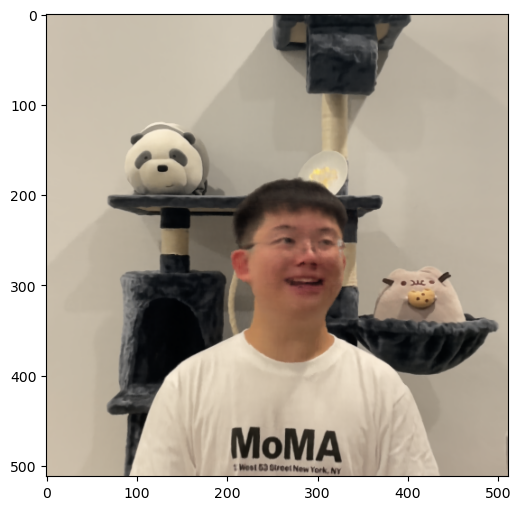


 92%|█████████▏| 12/13 [38:06<03:07, 187.29s/it]

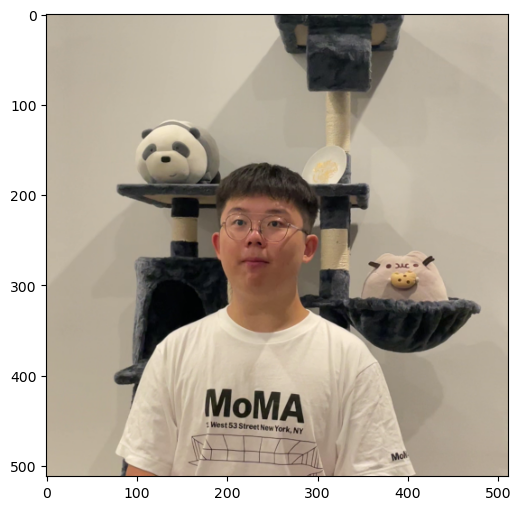

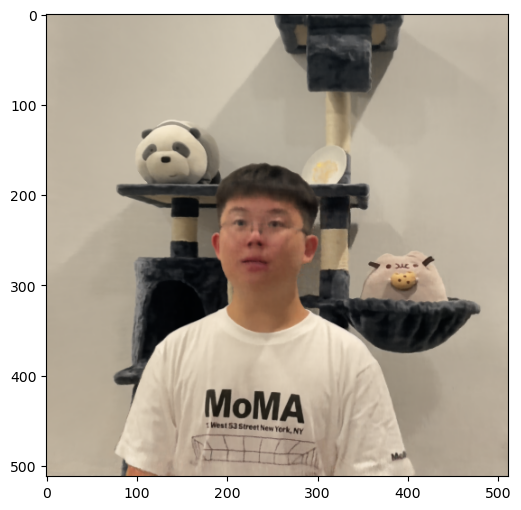

100%|██████████| 13/13 [41:27<00:00, 191.36s/it]


In [4]:
for i in tqdm(range(0,len(images),len(images)//12)): # len(images) is 131
    img_i = np.random.choice(i_train)
    target = images[img_i]
    pose = poses[img_i, :3, :4]
    warp = warps[img_i]
    appearance = appearances[img_i]
    param_3DMM_i = param_3DMM[img_i]
    mesh_canonical_i = mesh_canonicals[img_i]
    mesh_deformed_i = mesh_deformeds[img_i]

    with torch.no_grad():
        # batchify rays to avoid OOM issue
        rays_o, rays_d = get_rays(H, W, focal, pose, device)  # rays origin: (H, W, 3), rays direction: (H, W, 3)
        rgb_all = []
        disp_all = []
        acc_all = []
        extras_all = []

        # iteratively render the image by heights
        for i in range(0, H, 2):
            rays_o_chunk = rays_o[i:i+2]
            rays_d_chunk = rays_d[i:i+2]
            batch_rays = torch.stack([rays_o_chunk, rays_d_chunk], dim=0)
            rgb, _, _, _,_ = render(H, W, focal, chunk=args.chunk, rays=batch_rays, 
                                    frame_warp=warp, frame_appearance = appearance, 
                                    param_3DMM = param_3DMM_i, mesh_canonical = mesh_canonical_i, 
                                    mesh_deformed = mesh_deformed_i, **render_kwargs_test)
            rgb_all.append(rgb)

        rgb = torch.cat(rgb_all, dim=0)
        
        # Display and save the gt
        target = target.detach().cpu().numpy()
        target = to8b(target)
        cv2.imwrite(os.path.join(train_output_path, f'train_{img_i}_gt.png'),  cv2.cvtColor(target, cv2.COLOR_RGB2BGR))
        
        plt.figure(2, figsize=(20,6))
        plt.imshow(target)
        plt.show()
        
        
        # Display the image
        # Convert to numpy first
        rgb = rgb.detach().cpu().numpy()
        rgb = to8b(rgb)
         # save the image
        cv2.imwrite(os.path.join(train_output_path, f'train_{img_i}.png'),  cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR))
        
        plt.figure(2, figsize=(20,6))
        plt.imshow(rgb)
        plt.show()
        

## Load validation data details

In [5]:
vali_output_path = os.path.join(root_dir,"./vali_images")
if not os.path.exists(vali_output_path):
    os.makedirs(vali_output_path)

In [6]:
images, poses, warps, appearances, mesh_canonicals, mesh_deformeds,param_3DMM, near, far, hwf = load_nerfies_vali_data(args.datadir,args.section,downscale = args.downscale)
H, W, focal = hwf
H, W = int(H), int(W)
hwf = [H, W, focal]

# load the nerf model
_,render_kwargs_test,_,_,_ =  create_nerf(args,frame_num=frame_num)
bds_dict = {'near' : near,'far' : far}
render_kwargs_test.update(bds_dict)

# move data to device
images = torch.Tensor(images).to(device)
poses = torch.Tensor(poses).to(device)
warps = torch.Tensor(warps).to(device)
appearances = torch.Tensor(appearances).to(device)
param_3DMM = torch.Tensor(param_3DMM).to(device)
mesh_canonicals = torch.Tensor(mesh_canonicals).to(device)
mesh_deformeds = torch.Tensor(mesh_deformeds).to(device)


NeRF type selected: rignerf
Using two models for fine
NeRF type selected: rignerf
fine and coarse network created, frame_num is 2589
Found ckpts ['./logs/kuoyuan_home_glass/040000.tar', './logs/kuoyuan_home_glass/080000.tar', './logs/kuoyuan_home_glass/120000.tar', './logs/kuoyuan_home_glass/160000.tar', './logs/kuoyuan_home_glass/200000.tar', './logs/kuoyuan_home_glass/240000.tar', './logs/kuoyuan_home_glass/280000.tar']
Reloading from ./logs/kuoyuan_home_glass/280000.tar



  0%|          | 0/11 [00:00<?, ?it/s]

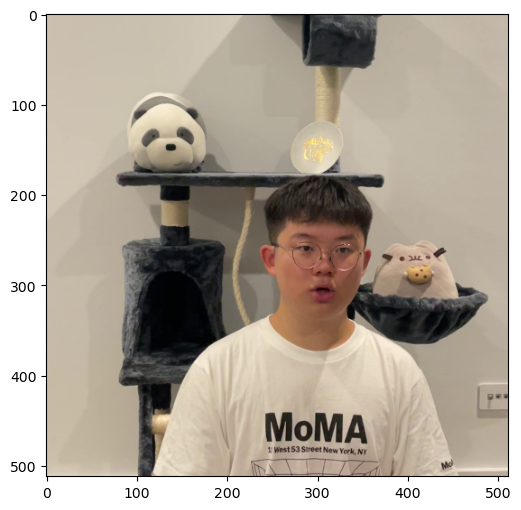

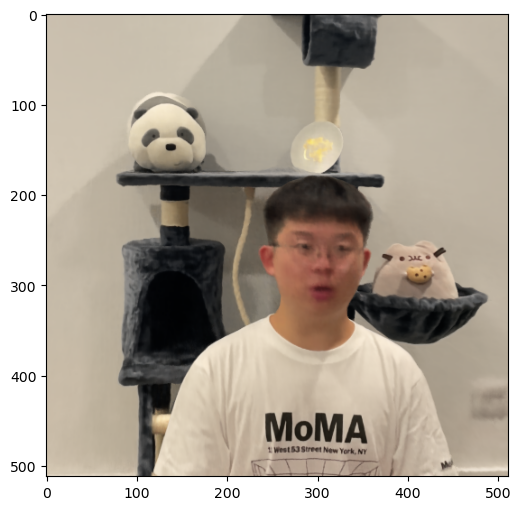


  9%|▉         | 1/11 [03:10<31:49, 190.99s/it]

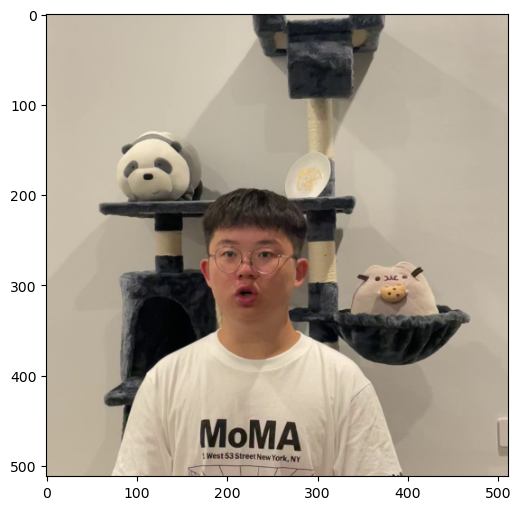

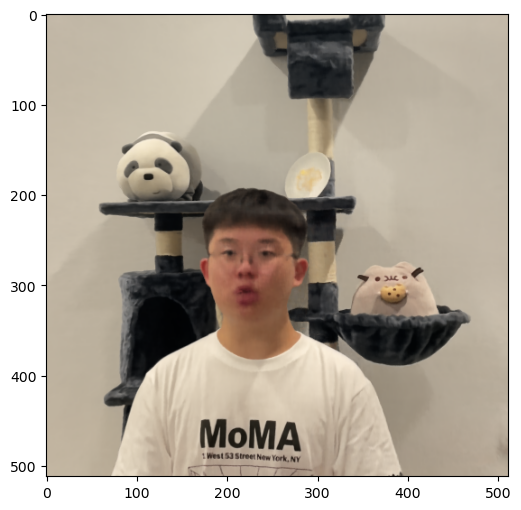


 18%|█▊        | 2/11 [06:25<28:57, 193.07s/it]

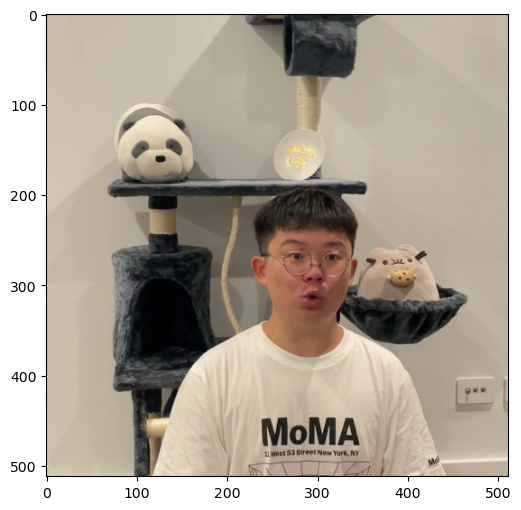

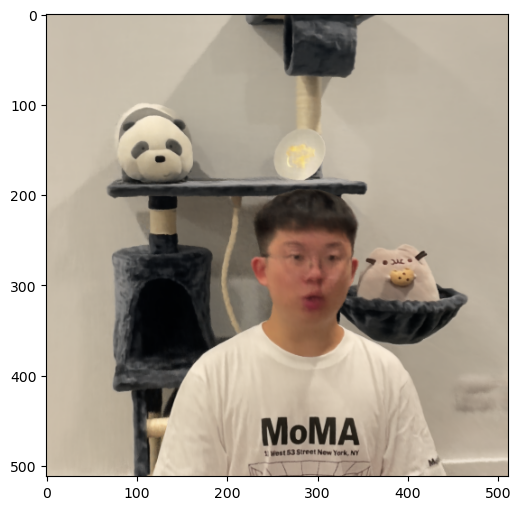


 27%|██▋       | 3/11 [09:50<26:29, 198.70s/it]

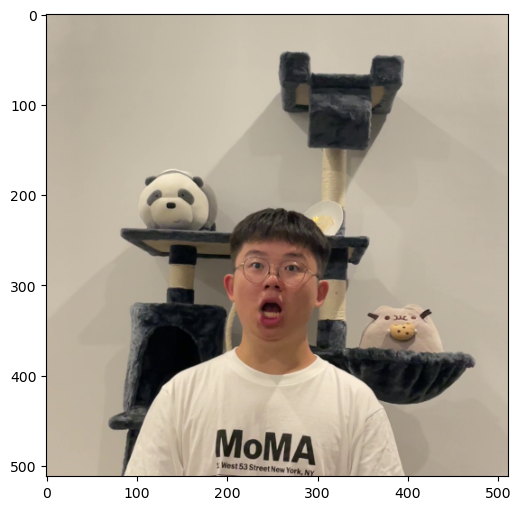

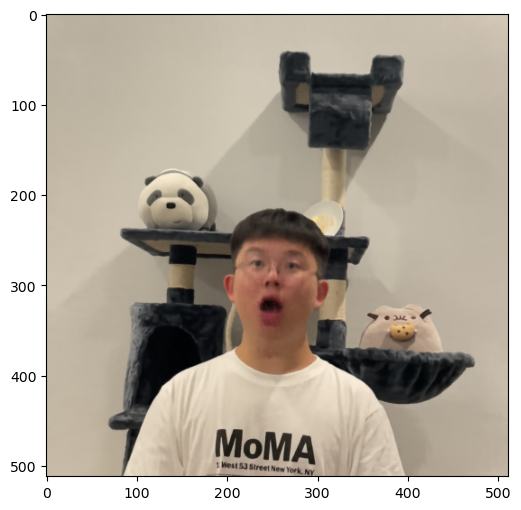


 36%|███▋      | 4/11 [13:37<24:29, 209.87s/it]

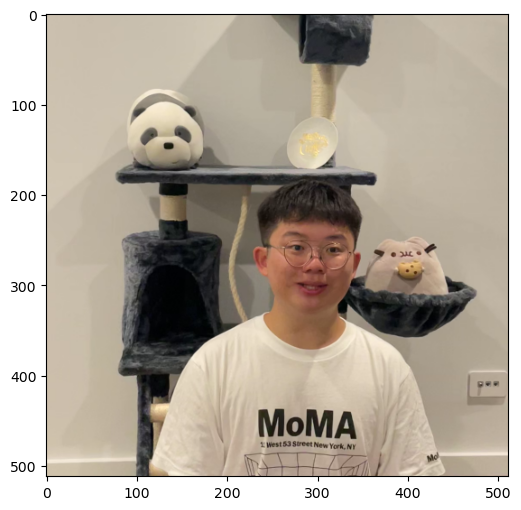

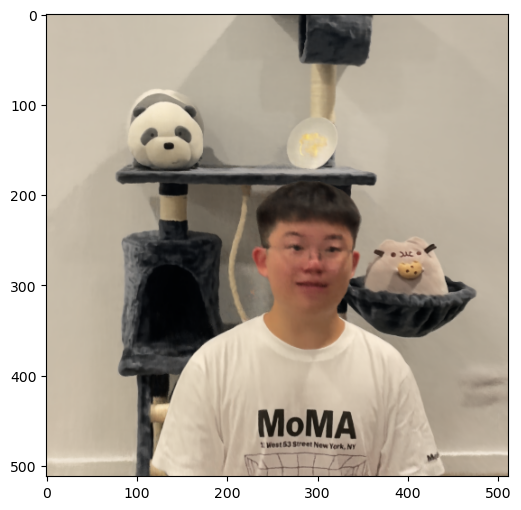


 45%|████▌     | 5/11 [17:02<20:47, 207.97s/it]

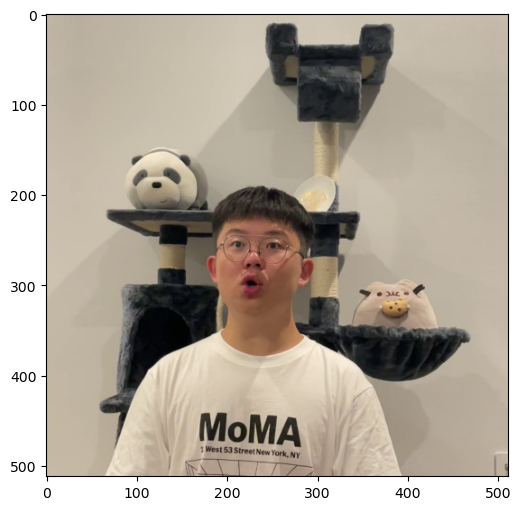

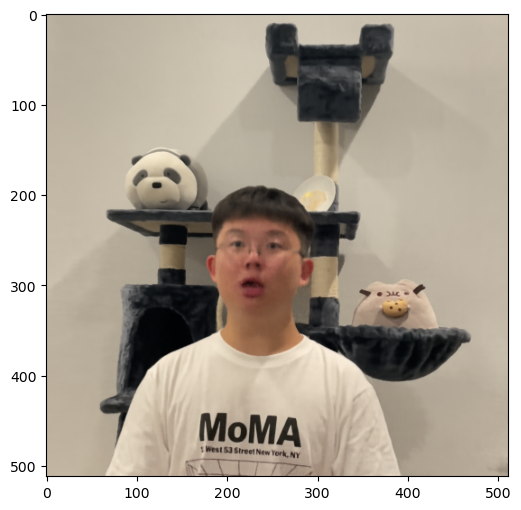


 55%|█████▍    | 6/11 [20:26<17:12, 206.54s/it]

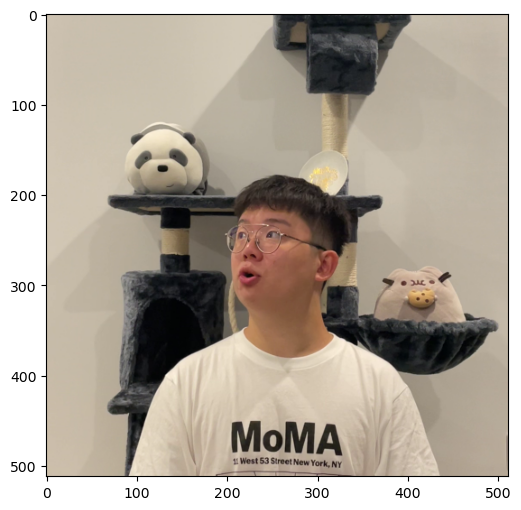

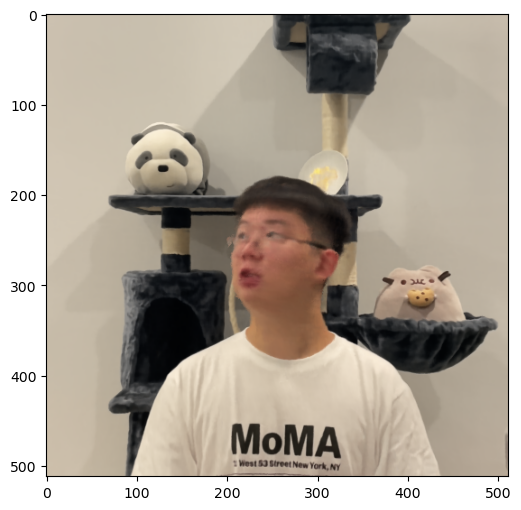


 64%|██████▎   | 7/11 [23:03<12:41, 190.38s/it]

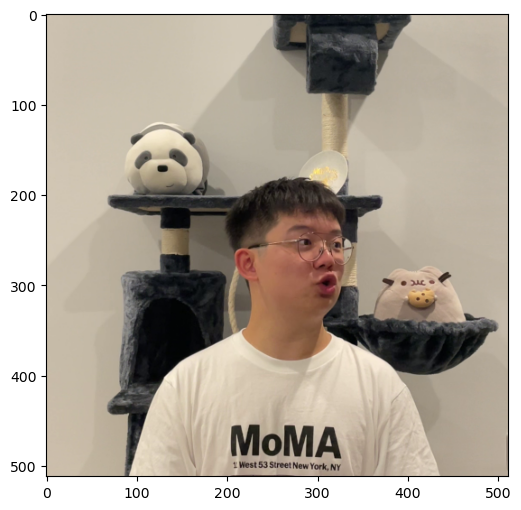

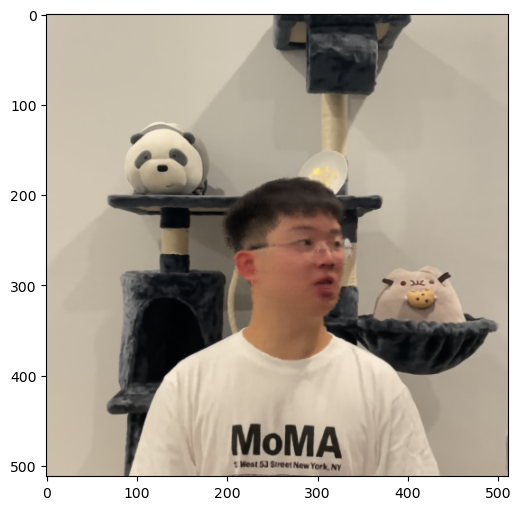


 73%|███████▎  | 8/11 [25:44<09:02, 180.91s/it]

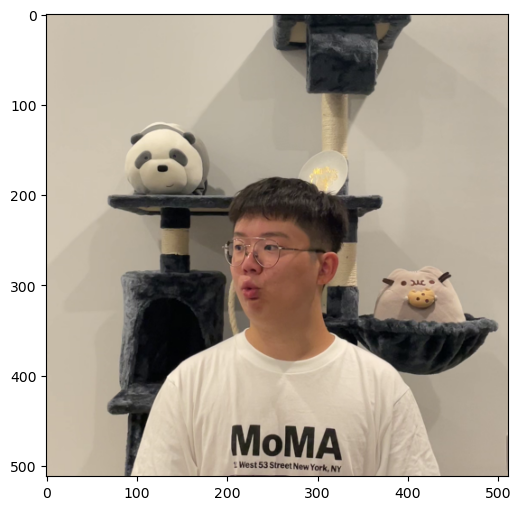

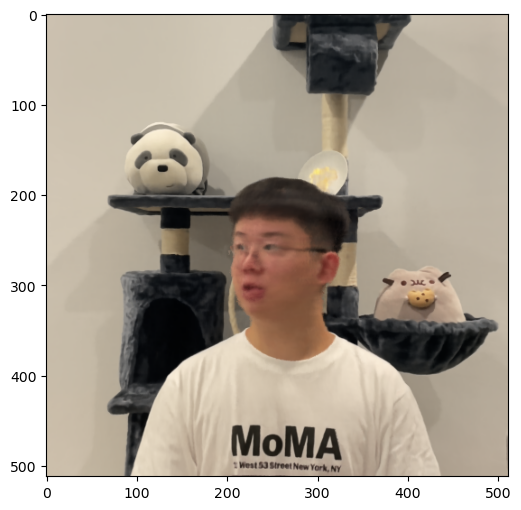


 82%|████████▏ | 9/11 [28:42<06:00, 180.26s/it]

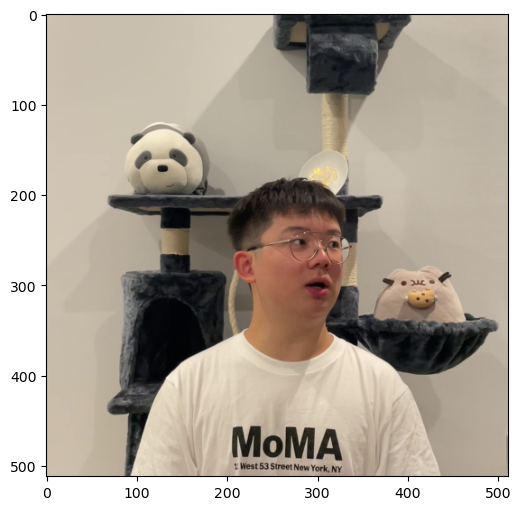

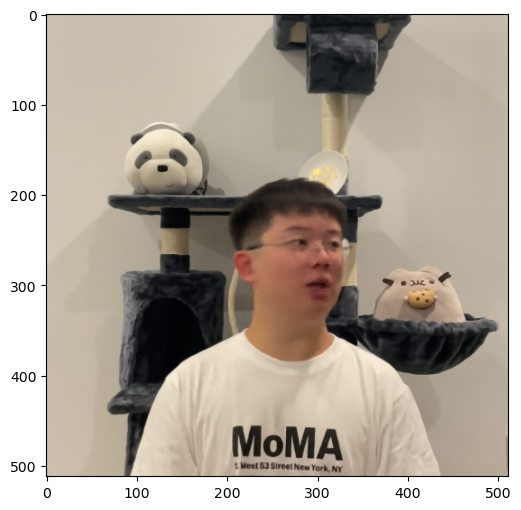


 91%|█████████ | 10/11 [31:25<02:54, 174.82s/it]

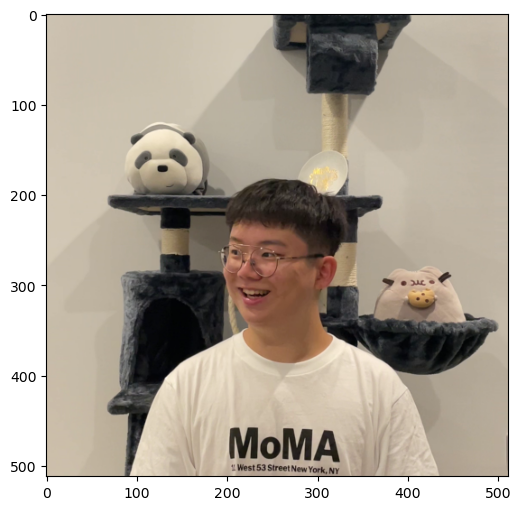

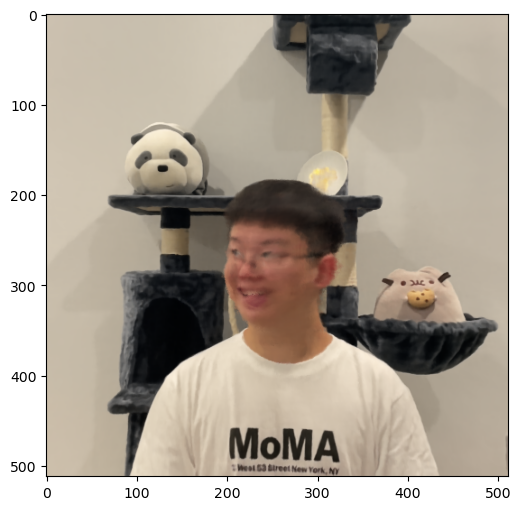

100%|██████████| 11/11 [34:15<00:00, 186.82s/it]


In [7]:
for img_i in tqdm(range(0,len(images),len(images)//10)): # len(images) is 131
    target = images[img_i]
    pose = poses[img_i, :3, :4]
    warp = warps[img_i]
    appearance = appearances[img_i]
    param_3DMM_i = param_3DMM[img_i]
    mesh_canonical_i = mesh_canonicals[img_i]
    mesh_deformed_i = mesh_deformeds[img_i]

    with torch.no_grad():
        # batchify rays to avoid OOM issue
        rays_o, rays_d = get_rays(H, W, focal, pose, device)  # rays origin: (H, W, 3), rays direction: (H, W, 3)
        rgb_all = []
        disp_all = []
        acc_all = []
        extras_all = []

        # iteratively render the image by heights
        for i in range(0, H, 2):
            rays_o_chunk = rays_o[i:i+2]
            rays_d_chunk = rays_d[i:i+2]
            batch_rays = torch.stack([rays_o_chunk, rays_d_chunk], dim=0)
            rgb, _, _, _,_ = render(H, W, focal, chunk=args.chunk, rays=batch_rays, 
                                    frame_warp=warp, frame_appearance = appearance, 
                                    param_3DMM = param_3DMM_i, mesh_canonical = mesh_canonical_i, 
                                    mesh_deformed = mesh_deformed_i, **render_kwargs_test)
            rgb_all.append(rgb)

        rgb = torch.cat(rgb_all, dim=0)
        
        # Display and save the gt
        target = target.detach().cpu().numpy()
        target = to8b(target)
        cv2.imwrite(os.path.join(vali_output_path, f'vali_{img_i}_gt.png'),  cv2.cvtColor(target, cv2.COLOR_RGB2BGR))
        
        plt.figure(2, figsize=(20,6))
        plt.imshow(target)
        plt.show()
        
        # Display the image
        # Convert to numpy first
        rgb = rgb.detach().cpu().numpy()
        rgb = to8b(rgb)
         # save the image
        cv2.imwrite(os.path.join(vali_output_path, f'vali_{img_i}.png'),  cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR))
        plt.figure(2, figsize=(20,6))
        plt.imshow(rgb)
        plt.show()
        

## Load test data - same mesh (expression+pose) from unseen viewpoints

In [23]:
mesh_id = 'p3_000728'
test_output_path =  os.path.join(root_dir,f"./test_output_{mesh_id}")
if not os.path.exists(test_output_path):
    os.makedirs(test_output_path)
    
# Load the mesh and parameter of the mesh
basedir = args.datadir
# Load the image size
H,W = 512,512
mesh_canonical_path = os.path.join(basedir, 'mesh_canonical/canonical_mesh_colmap_coordinate.npy')
mesh_deformed_path = os.path.join(basedir, f'mesh_deformed/{mesh_id}_mesh_colmap_coordinate.npy')
param_3DMM_path = os.path.join(basedir, 'exp_pose_dict.json')

# Based on the dataset.json file, determine which images are train and test
camera_path = os.path.join(basedir, 'test_camera/orbit-mild')
scene_path = os.path.join(basedir, 'scene.json')
# load 3DMM parameters
param_3DMM = json.load(open(param_3DMM_path))
test_cameras = os.listdir(camera_path)
test_cameras = sorted(test_cameras, key=lambda x: int(x.split('.')[0]))
warp_code, appearance_code = 0,0
all_poses = []
all_warp = []
all_appearance = []
all_mesh_canonical = []
all_mesh_deformed = []
all_param_3DMM = []

In [24]:
for test_camera in test_cameras:
    # load camera pose (4x4 matric)
    test_camera_path = os.path.join(camera_path, test_camera)
    camera = json.load(open(test_camera_path))
    camera_orientation = np.asarray(camera['orientation']).T
    camera_position = np.asarray(camera['position'])
    camera_pose = np.vstack([np.hstack([camera_orientation, camera_position.reshape(3,1)]), np.asarray([0,0,0,1])])
    camera_pose = camera_pose.astype(np.float32)
    all_poses.append(camera_pose)

    # Load the warp and appearance code 
    # Use 0 for validation
    all_warp.append(warp_code)
    all_appearance.append(appearance_code)

    # load mesh canonical
    mesh_canonical = np.load(mesh_canonical_path)
    mesh_canonical = mesh_canonical.astype(np.float32)
    all_mesh_canonical.append(mesh_canonical)

    # load mesh deformed
    mesh_deformed = np.load(mesh_deformed_path)
    mesh_deformed = mesh_deformed.astype(np.float32)
    all_mesh_deformed.append(mesh_deformed)
    
    # load param_3DMM
    param_3DMM_exp = param_3DMM[mesh_id]['exp'][0]
    param_3DMM_pose = param_3DMM[mesh_id]['pose'][0]
    param_3DMM_i = np.concatenate([param_3DMM_exp, param_3DMM_pose])
    param_3DMM_i = param_3DMM_i.astype(np.float32)
    all_param_3DMM.append(param_3DMM_i)


assert len(all_poses) == len(all_warp) == len(all_appearance) == len(all_mesh_canonical) == len(all_mesh_deformed) == len(all_param_3DMM)

# Load the camera focal length
camera_one = json.load(open(os.path.join(camera_path, '000000.json')))
camera_focal = camera_one['focal_length'] 

# Load the scene near and far
scene = json.load(open(scene_path))
near, far = scene['near'], scene['far']


# if os.path.exists(os.path.join(basedir, 'transforms_{}.json'.format('render'))): # render file 
#     with open(os.path.join(basedir, 'transforms_{}.json'.format('render')), 'r') as fp:
#         meta = json.load(fp)
#     render_poses = [] # the camera pose matrix
#     for frame in meta['frames']:
#         render_poses.append(np.array(frame['transform_matrix']))
#     render_poses = np.array(render_poses).astype(np.float32)
# else:
#     render_poses = torch.stack([pose_spherical(angle, -30.0, 4.0) for angle in np.linspace(-180,180,40+1)[:-1]], 0)
# render_times = torch.linspace(0., 1., render_poses.shape[0])
    
# convert to numpy array
all_poses = np.asarray(all_poses)
all_warp = np.asarray(all_warp)
all_appearance = np.asarray(all_appearance)
all_mesh_canonical = np.asarray(all_mesh_canonical)
all_mesh_deformed = np.asarray(all_mesh_deformed)
all_param_3DMM = np.asarray(all_param_3DMM)

# Move data to device
all_poses = torch.from_numpy(all_poses).to(device)
all_warp = torch.from_numpy(all_warp).to(device)
all_appearance = torch.from_numpy(all_appearance).to(device)
all_mesh_canonical = torch.from_numpy(all_mesh_canonical).to(device)
all_mesh_deformed = torch.from_numpy(all_mesh_deformed).to(device)
all_param_3DMM = torch.from_numpy(all_param_3DMM).to(device)

### Create and load rignerf model

In [25]:
_,render_kwargs_test,_,_,_ =  create_nerf(args,frame_num=frame_num)
bds_dict = {'near' : near,'far' : far}
render_kwargs_test.update(bds_dict)

NeRF type selected: rignerf
Using two models for fine
NeRF type selected: rignerf
fine and coarse network created, frame_num is 2589
Found ckpts ['./logs/kuoyuan_home_glass/040000.tar', './logs/kuoyuan_home_glass/080000.tar', './logs/kuoyuan_home_glass/120000.tar', './logs/kuoyuan_home_glass/160000.tar', './logs/kuoyuan_home_glass/200000.tar', './logs/kuoyuan_home_glass/240000.tar', './logs/kuoyuan_home_glass/280000.tar']
Reloading from ./logs/kuoyuan_home_glass/280000.tar


### Render videos

In [26]:
all_rendered_imgs = []
rendered_images_file = os.listdir(test_output_path)
rendered_images = sorted([int(i.strip().split('.')[0].split('_')[1]) for i in rendered_images_file])
# load rendered images
for rendered_id in rendered_images:
    rendered_image = cv2.imread(os.path.join(test_output_path,f'test_{rendered_id}.png'))
    rendered_image = cv2.cvtColor(rendered_image, cv2.COLOR_RGB2BGR)
    all_rendered_imgs.append(rendered_image)


  0%|          | 0/200 [00:00<?, ?it/s]

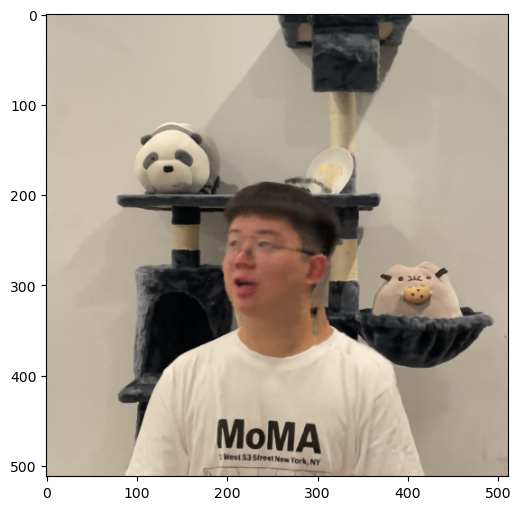


  0%|          | 1/200 [02:42<9:00:14, 162.89s/it]

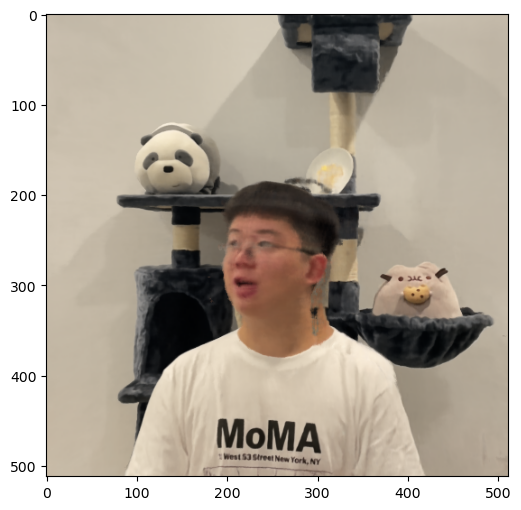


  1%|          | 2/200 [05:25<8:57:53, 163.00s/it]

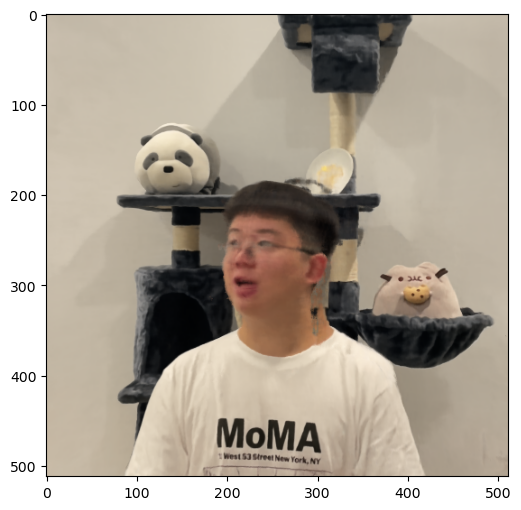


  2%|▏         | 3/200 [08:08<8:54:18, 162.73s/it]

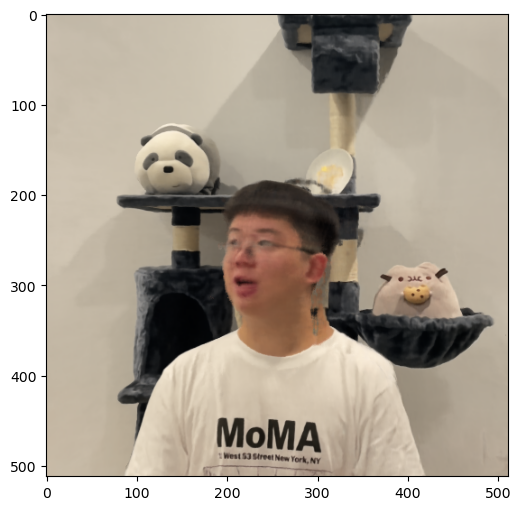


  2%|▏         | 4/200 [10:51<8:52:04, 162.88s/it]

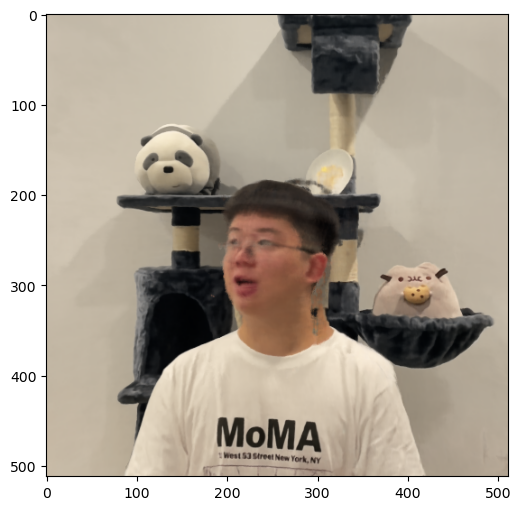


  2%|▎         | 5/200 [13:36<8:51:39, 163.58s/it]

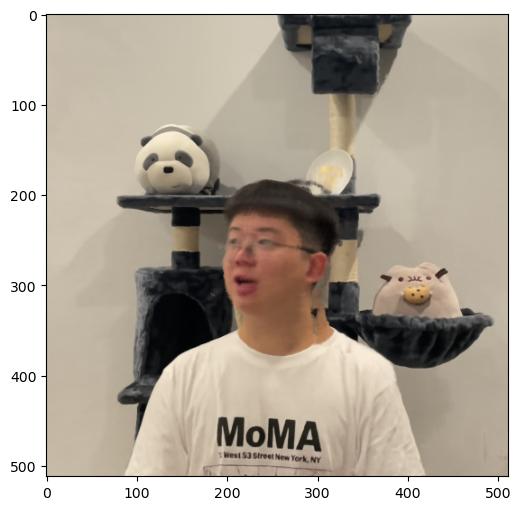


  3%|▎         | 6/200 [16:21<8:50:22, 164.03s/it]

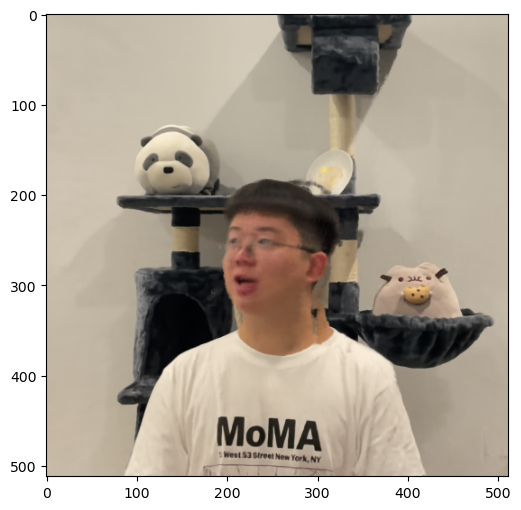


  4%|▎         | 7/200 [19:02<8:45:04, 163.24s/it]

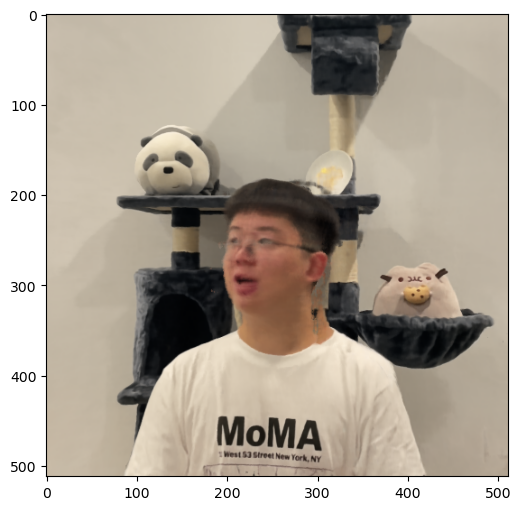


  4%|▍         | 8/200 [21:47<8:44:08, 163.79s/it]

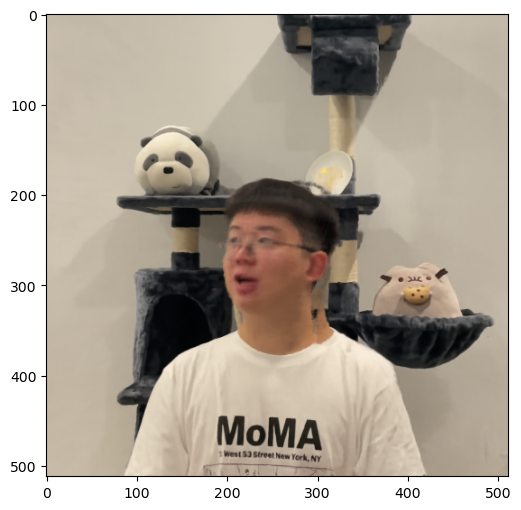


  4%|▍         | 9/200 [24:31<8:41:24, 163.79s/it]

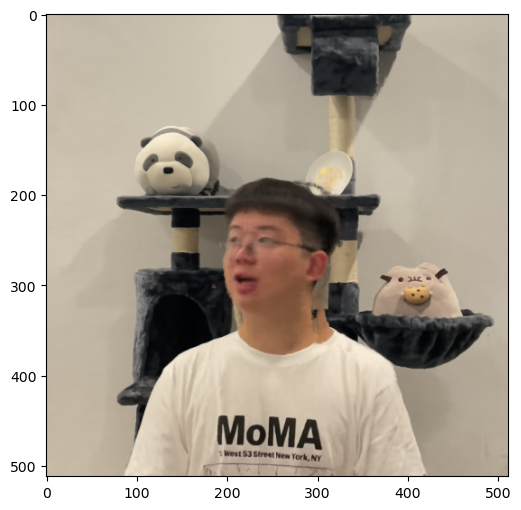


  5%|▌         | 10/200 [27:14<8:37:43, 163.49s/it]

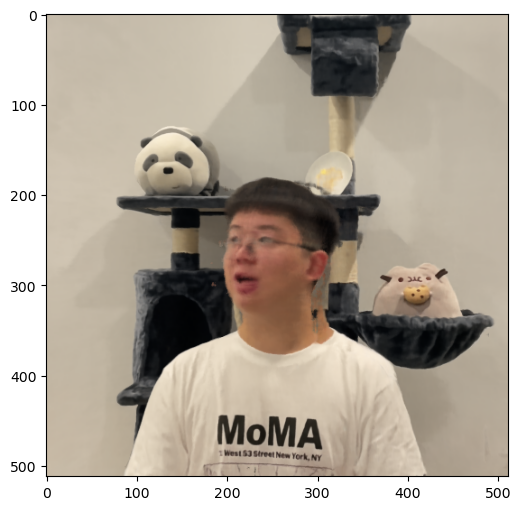


  6%|▌         | 11/200 [29:58<8:35:27, 163.64s/it]

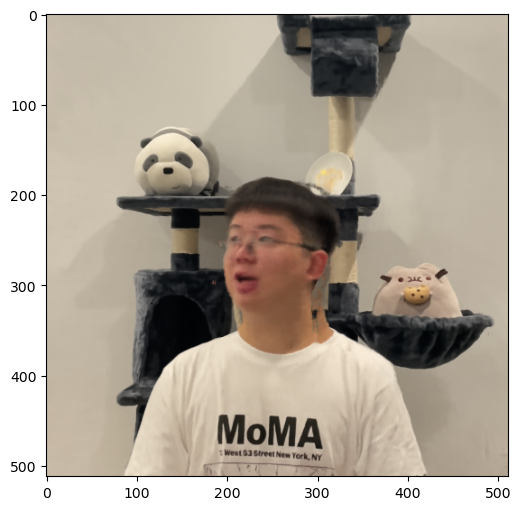


  6%|▌         | 12/200 [32:42<8:33:12, 163.79s/it]

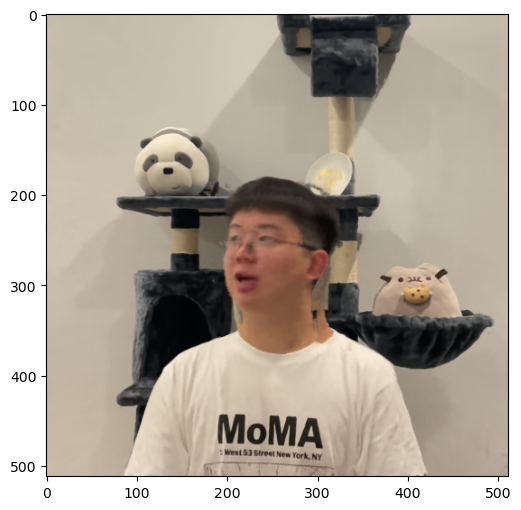


  6%|▋         | 13/200 [35:28<8:32:23, 164.40s/it]

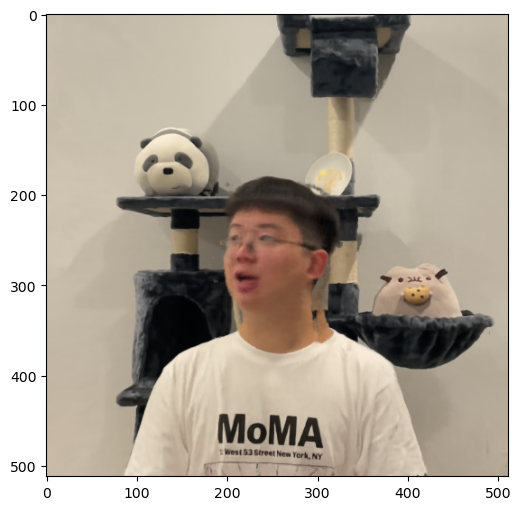


  7%|▋         | 14/200 [38:11<8:28:42, 164.10s/it]

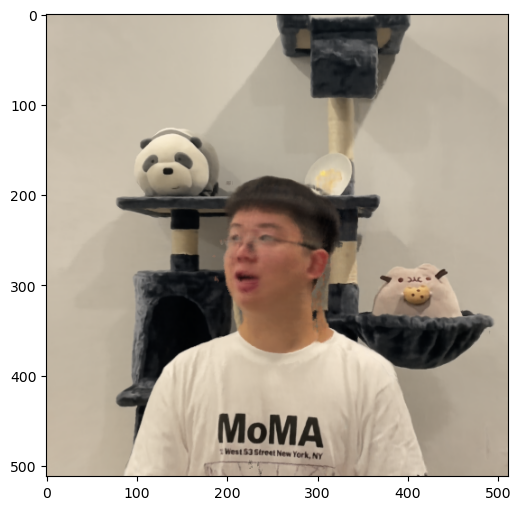


  8%|▊         | 15/200 [40:56<8:26:28, 164.26s/it]

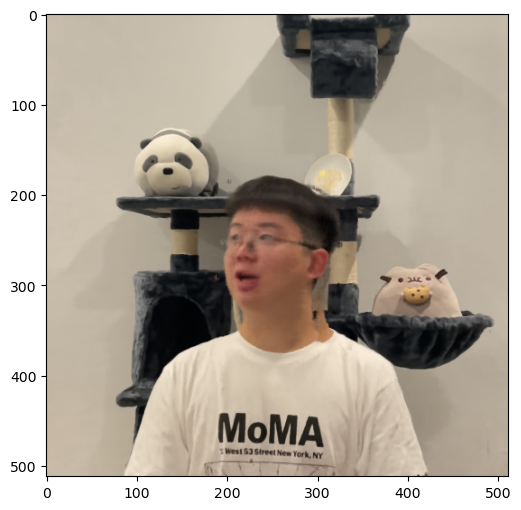


  8%|▊         | 16/200 [43:45<8:28:01, 165.66s/it]

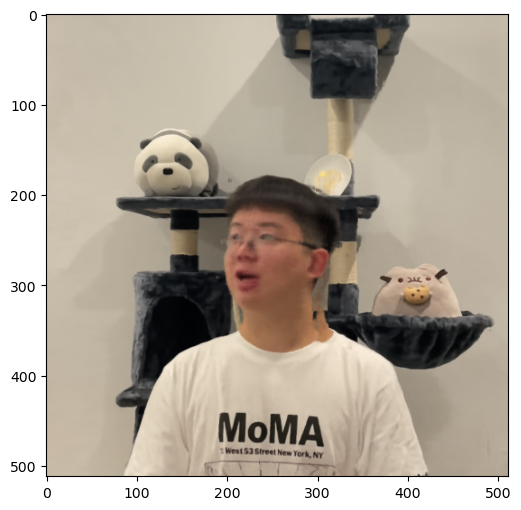


  8%|▊         | 17/200 [46:27<8:22:28, 164.75s/it]

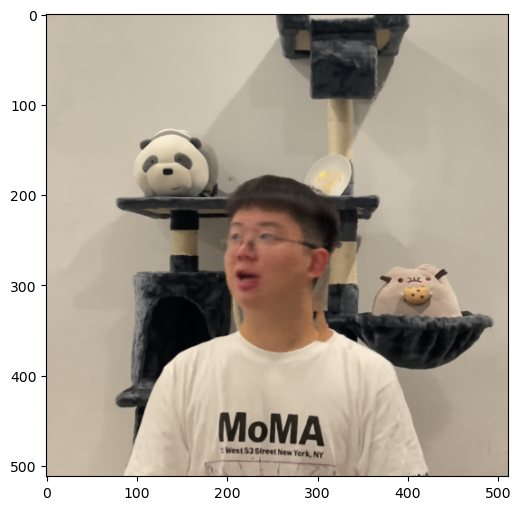


  9%|▉         | 18/200 [49:10<8:18:10, 164.23s/it]

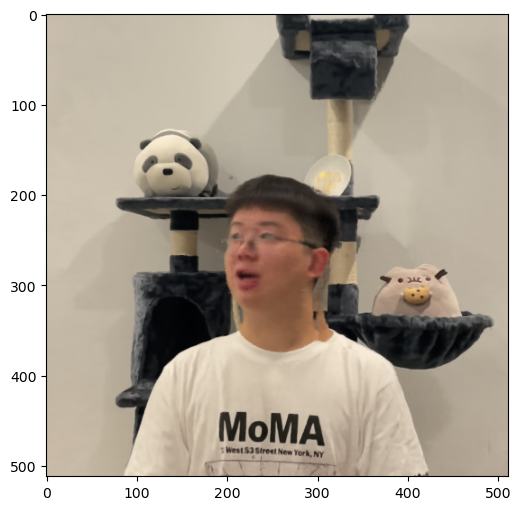


 10%|▉         | 19/200 [51:55<8:15:39, 164.31s/it]

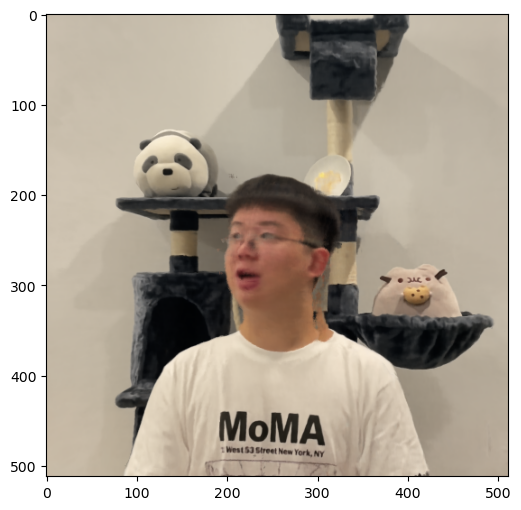


 10%|█         | 20/200 [54:44<8:17:00, 165.67s/it]

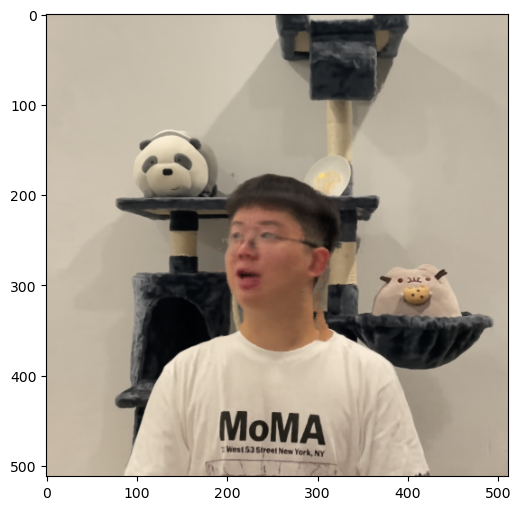


 10%|█         | 21/200 [57:29<8:13:33, 165.44s/it]

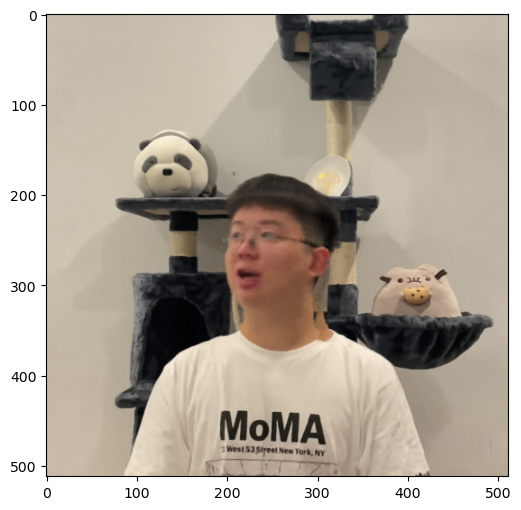


 11%|█         | 22/200 [1:00:12<8:09:02, 164.85s/it]

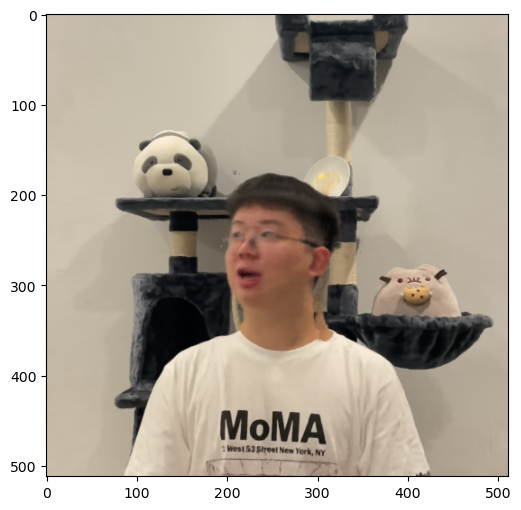


 12%|█▏        | 23/200 [1:02:53<8:02:58, 163.72s/it]

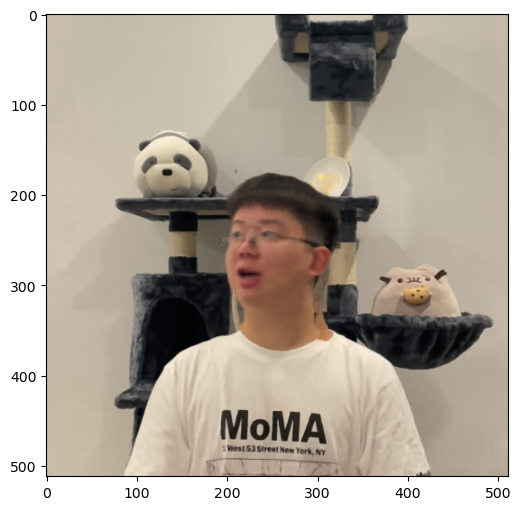


 12%|█▏        | 24/200 [1:05:34<7:58:01, 162.96s/it]

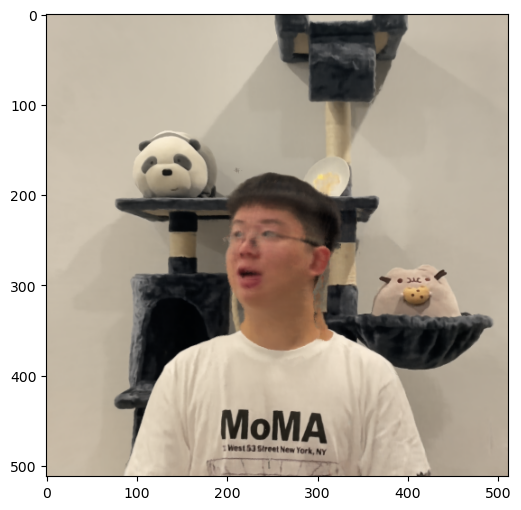


 12%|█▎        | 25/200 [1:08:16<7:53:40, 162.40s/it]

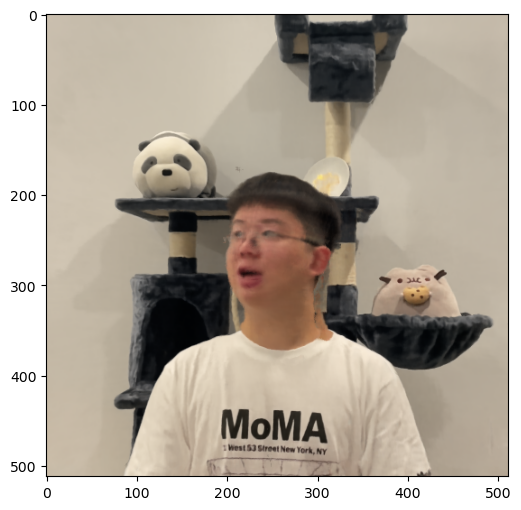


 13%|█▎        | 26/200 [1:10:57<7:50:25, 162.22s/it]

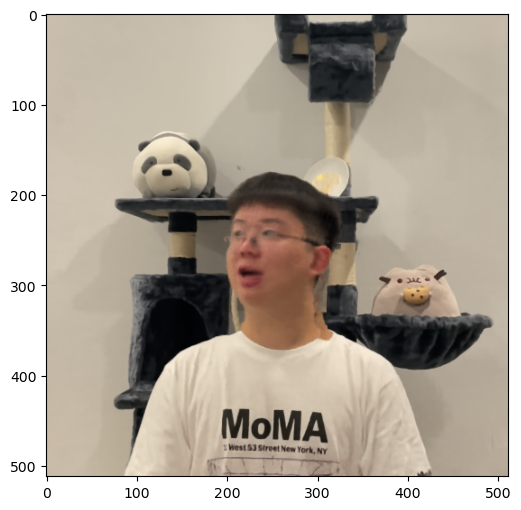


 14%|█▎        | 27/200 [1:13:41<7:48:52, 162.62s/it]

In [ ]:
for i_img in tqdm(range(0,len(all_poses))):
    if i_img in rendered_images:
        continue
    pose = all_poses[i_img,:3, :4]
    warp = all_warp[i_img]
    appearance = all_appearance[i_img]
    mesh_canonical_i = all_mesh_canonical[i_img]
    mesh_deformed_i = all_mesh_deformed[i_img]
    param_3DMM_i = all_param_3DMM[i_img]

    with torch.no_grad():
        rays_o, rays_d = get_rays(H, W, camera_focal, pose, device)
        rgb_all = []

        # iteratively render the image by heights
        for i in range(0, H,2):
            rays_o_chunk = rays_o[i:i+2]
            rays_d_chunk = rays_d[i:i+2]
            batch_rays = torch.stack([rays_o_chunk, rays_d_chunk], dim=0)
            rgb,_,_,_,_ = render(H, W, camera_focal, chunk=args.chunk, rays=batch_rays, 
                                    frame_warp=warp, frame_appearance = appearance, 
                                    param_3DMM = param_3DMM_i, mesh_canonical = mesh_canonical_i, 
                                    mesh_deformed = mesh_deformed_i, **render_kwargs_test)
            rgb_all.append(rgb)


        rgb = torch.cat(rgb_all, dim=0)

        # Display the image
        # Convert to numpy first
        rgb = rgb.detach().cpu().numpy()
        rgb = to8b(rgb)
        # save image
        cv2.imwrite(os.path.join(test_output_path, f'test_{i_img}.png'), cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR))
        plt.figure(2, figsize=(20,6))
        plt.imshow(rgb)
        plt.show()
        # add to all images
        all_rendered_imgs.append(rgb)

In [ ]:
# render list of images to video
fps = 30
video_out = cv2.VideoWriter(os.path.join(test_output_path, 'test_video.mp4'), cv2.VideoWriter_fourcc(*'mp4v'), fps, (W, H))
for i in range(len(all_rendered_imgs)):
    video_out.write(cv2.cvtColor(all_rendered_imgs[i], cv2.COLOR_RGB2BGR))
video_out.release()

## Load test data details (old)

In [ ]:
# Constants
H,W = 480,270
frame_num = 2483
test_output_path = "./test_images"
if not os.path.exists(test_output_path):
    os.makedirs(test_output_path)
# Only nerfies data
assert args.dataset_type == 'nerfies'

test_dir = os.path.join(args.datadir, 'testset')
# File directory for test images
dataset_json = os.path.join(test_dir, 'dataset.json')
camera_path = os.path.join(test_dir, 'camera')
mesh_canonical_path = os.path.join(test_dir, 'mesh_canonical')
mesh_deformed_path = os.path.join(test_dir, 'mesh_deformed')
param_3DMM_path = os.path.join(test_dir,'exp_pose_dict.json' )
metadata_path = os.path.join(test_dir, 'metadata.json')
scene_path = os.path.join(args.datadir, 'scene.json')

# load dataset and metadata
dataset = json.load(open(dataset_json))
metadatas = json.load(open(metadata_path))
param_3DMM = json.load(open(param_3DMM_path))
ids = dataset['test_ids']

all_poses = []
all_warp = []
all_appearance = []
all_mesh_canonical = []
all_mesh_deformed = []
all_param_3DMM = []

for i in ids:
    # load camera pose (4x4 matric)
    camera_path_i = os.path.join(camera_path, f'{i}.json')
    camera = json.load(open(camera_path_i))
    camera_orientation = np.asarray(camera['orientation'])
    camera_position = np.asarray(camera['position'])
    camera_pose = np.vstack([np.hstack([camera_orientation, camera_position.reshape(3,1)]), np.asarray([0,0,0,1])])
    camera_pose = camera_pose.astype(np.float32)
    all_poses.append(camera_pose)

    # Load the warp and appearance code 
    all_warp.append(metadatas[i]['warp_id'])
    all_appearance.append(metadatas[i]['appearance_id'])

    # load mesh canonical
    mesh_canonical_path_i = os.path.join(mesh_canonical_path, 'canonical_mesh_colmap_coordinate.npy')
    mesh_canonical = np.load(mesh_canonical_path_i)
    mesh_canonical = mesh_canonical.astype(np.float32)
    all_mesh_canonical.append(mesh_canonical)

    # load mesh deformed
    mesh_deformed_path_i = os.path.join(mesh_deformed_path, f'{i}_mesh_colmap_coordinate.npy')
    mesh_deformed = np.load(mesh_deformed_path_i)
    mesh_deformed = mesh_deformed.astype(np.float32)
    all_mesh_deformed.append(mesh_deformed)
    
    # load param_3DMM
    param_3DMM_exp = param_3DMM[i]['exp'][0]
    param_3DMM_pose = param_3DMM[i]['pose'][0]
    param_3DMM_i = np.concatenate([param_3DMM_exp, param_3DMM_pose])
    param_3DMM_i = param_3DMM_i.astype(np.float32)
    all_param_3DMM.append(param_3DMM_i)

    # Load the camera focal length
camera_one = json.load(open(os.path.join(camera_path, '000001.json')))
camera_focal = camera_one['focal_length'] 

# Load the scene near and far
scene = json.load(open(scene_path))
near, far = scene['near'], scene['far']

# convert to numpy array
all_poses = np.asarray(all_poses)
all_warp = np.asarray(all_warp)
all_appearance = np.asarray(all_appearance)
all_mesh_canonical = np.asarray(all_mesh_canonical)
all_mesh_deformed = np.asarray(all_mesh_deformed)
all_param_3DMM = np.asarray(all_param_3DMM)

# Move data to device
all_poses = torch.from_numpy(all_poses).to(device)
all_warp = torch.from_numpy(all_warp).to(device)
all_appearance = torch.from_numpy(all_appearance).to(device)
all_mesh_canonical = torch.from_numpy(all_mesh_canonical).to(device)
all_mesh_deformed = torch.from_numpy(all_mesh_deformed).to(device)
all_param_3DMM = torch.from_numpy(all_param_3DMM).to(device)


### Create and load model parameters

In [ ]:

_,render_kwargs_test,_,_,_ =  create_nerf(args,frame_num=frame_num)
bds_dict = {'near' : near,'far' : far}
render_kwargs_test.update(bds_dict)


### Render images

In [ ]:


for i_img in range(0,len(all_poses)):
    pose = all_poses[i_img,:3, :4]
    warp = all_warp[i_img]
    appearance = all_appearance[i_img]
    mesh_canonical_i = all_mesh_canonical[i_img]
    mesh_deformed_i = all_mesh_deformed[i_img]
    param_3DMM_i = all_param_3DMM[i_img]

    with torch.no_grad():
        rays_o, rays_d = get_rays(H, W, camera_focal, pose, device)
        rgb_all = []

        # iteratively render the image by heights
        for i in range(0, H,2):
            rays_o_chunk = rays_o[i:i+2]
            rays_d_chunk = rays_d[i:i+2]
            batch_rays = torch.stack([rays_o_chunk, rays_d_chunk], dim=0)
            rgb, _, _,_ = render(H, W, camera_focal, chunk=args.chunk, rays=batch_rays, 
                                    frame_warp=warp, frame_appearance = appearance, 
                                    param_3DMM = param_3DMM_i, mesh_canonical = mesh_canonical_i, 
                                    mesh_deformed = mesh_deformed_i, **render_kwargs_test)
            rgb_all.append(rgb)


        rgb = torch.cat(rgb_all, dim=0)

        # Display the image
        # Convert to numpy first
        rgb = rgb.detach().cpu().numpy()
        rgb = to8b(rgb)
        # save image
        cv2.imwrite(os.path.join(test_output_path, f'test_{i_img}.png'), cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR))
        plt.figure(2, figsize=(20,6))
        plt.imshow(rgb)
        plt.show()
